In [ ]:
import os
import librosa
import numpy as np
import soundfile
import IPython
import shutil
import pandas as pd

import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import TensorDataset, DataLoader

from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import MinMaxScaler, LabelEncoder
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_percentage_error
from sklearn.model_selection import train_test_split

import matplotlib.pyplot as plt
import cv2
from imutils import paths
from tqdm import tqdm

from tensorflow.keras.models import model_from_json
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint

import warnings
warnings.filterwarnings("ignore")

In [11]:
import os
import shutil
import subprocess

def download_and_extract_librispeech(destination_folder="/kaggle/working"):
    librispeech_url = "http://openslr.elda.org/resources/12/dev-clean.tar.gz"
    librispeech_tar = os.path.join(destination_folder, "dev-clean.tar.gz")
    clean_speech_folder = os.path.join(destination_folder, "clean_speech")

    subprocess.run(["wget", librispeech_url, "-O", librispeech_tar])
    subprocess.run(["tar", "-xvf", librispeech_tar, "-C", destination_folder])
    
    os.makedirs(clean_speech_folder, exist_ok=True)

    for root, _, files in os.walk(os.path.join(destination_folder, "LibriSpeech/dev-clean")):
        for file in files:
            if file.endswith(".flac"):
                src = os.path.join(root, file)
                dest = os.path.join(clean_speech_folder, file)
                shutil.copy2(src, dest)

    shutil.rmtree(os.path.join(destination_folder, "LibriSpeech"))

    print(f"Clean speech files saved to {clean_speech_folder}")


def download_and_extract_esc50(destination_folder="/kaggle/working"):
    esc50_url = "https://codeload.github.com/karolpiczak/ESC-50/zip/refs/heads/master"
    esc50_zip = os.path.join(destination_folder, "ESC-50-master.zip")
    noise_folder = os.path.join(destination_folder, "noise")

    subprocess.run(["wget", esc50_url, "-O", esc50_zip])
    subprocess.run(["unzip", esc50_zip, "-d", destination_folder])

    os.makedirs(noise_folder, exist_ok=True)

    for root, _, files in os.walk(os.path.join(destination_folder, "ESC-50-master/audio")):
        for file in files:
            if file.endswith(".wav"):
                src = os.path.join(root, file)
                dest = os.path.join(noise_folder, file)
                shutil.copy2(src, dest)

    shutil.rmtree(os.path.join(destination_folder, "ESC-50-master"))

    print(f"Noise files saved to {noise_folder}")

In [ ]:
download_and_extract_librispeech()
download_and_extract_esc50()

--2025-05-06 16:19:15--  http://openslr.elda.org/resources/12/dev-clean.tar.gz
Resolving openslr.elda.org (openslr.elda.org)... 141.94.109.138, 2001:41d0:203:ad8a::
Connecting to openslr.elda.org (openslr.elda.org)|141.94.109.138|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 337926286 (322M) [application/x-gzip]
Saving to: ‘/kaggle/working/dev-clean.tar.gz’

     0K .......... .......... .......... .......... ..........  0%  171K 32m9s
    50K .......... .......... .......... .......... ..........  0%  342K 24m6s
   100K .......... .......... .......... .......... ..........  0%  239M 16m4s
   150K .......... .......... .......... .......... ..........  0%  342K 16m4s
   200K .......... .......... .......... .......... ..........  0% 77.3M 12m52s
   250K .......... .......... .......... .......... ..........  0%  344K 13m23s
   300K .......... .......... .......... .......... ..........  0% 45.2M 11m29s
   350K .......... .......... .......... .......... ....

In [ ]:
count_clean = 0
duration_clean = 0
duration_noise = 0
sample_rate=8000

for i in os.listdir('/kaggle/working/clean_speech'):
  count_clean += 1
  y,sr = librosa.load(os.path.join('/kaggle/working/clean_speech',i),sr=sample_rate)
  duration = librosa.get_duration(y=y,sr=sr)
  duration_clean+=duration

print(f'Number of clean audio files are {count_clean}')
print(f'Total duration of all clean audios {duration_clean//60}')

count_noise = 0
for i in os.listdir('/kaggle/working/noise'):
  count_noise += 1
  y,sr = librosa.load(os.path.join('/kaggle/working/noise',i),sr=sample_rate)
  duration = librosa.get_duration(y=y,sr=sr)
  duration_noise+=duration

print(f'Number of Noisy audio files are {count_noise}')
print(f'Total duration of all noise audios {duration_noise//60}')

In [ ]:
def audio_to_audio_frame_stack(sound_data, frame_length, hop_length_frame):
    """This function take an audio and split into several frame
       in a numpy matrix of size (nb_frame,frame_length)"""

    sequence_sample_length = sound_data.shape[0]
    sound_data_list = [sound_data[start:start + frame_length] for start in range(
    0, sequence_sample_length - frame_length + 1, hop_length_frame)]
    sound_data_array = np.vstack(sound_data_list)
    return sound_data_array

In [ ]:
noise_dir="/kaggle/working/noise/"
voice_dir="/kaggle/working/clean_speech/"
path_save_spectrogram="/kaggle/working/spectogram/"
sample_rate=8000
min_duration=5.0
frame_length=8064
hop_length_frame=8064
hop_length_frame_noise=5000
nb_samples=500
n_fft=255
hop_length_fft=63
dim_square_spec = int(n_fft / 2) + 1

In [ ]:
clean_audio_files = os.listdir(voice_dir)
clean_random_audio = np.random.choice(clean_audio_files)
y,sr = librosa.load(os.path.join(voice_dir,clean_random_audio),sr=sample_rate)
clean = audio_to_audio_frame_stack(y,frame_length,hop_length_frame)
print("Clean Audio: {}".format(clean_random_audio))
print("Shape:{}".format(clean.shape))

In [ ]:
noisy_audio_files = os.listdir(noise_dir)
noisy_random_audio = np.random.choice(noisy_audio_files)
y,sr = librosa.load(os.path.join(noise_dir,noisy_random_audio),sr=sample_rate)
noise = audio_to_audio_frame_stack(y,frame_length,hop_length_frame)
print("Noise Audio: {}".format(noisy_random_audio))
print("Shape:{}".format(noise.shape))

In [ ]:
clean = np.vstack(clean)
noise = np.vstack(noise)

In [ ]:
print(clean)
print(noise)

In [ ]:
def blend_noise_randomly(voice, noise, nb_samples, frame_length):
    prod_voice = np.zeros((nb_samples, frame_length))
    prod_noise = np.zeros((nb_samples, frame_length))
    prod_noisy_voice = np.zeros((nb_samples, frame_length))

    for i in range(nb_samples):
        id_voice = np.random.randint(0, voice.shape[0])
        id_noise = np.random.randint(0, noise.shape[0])
        level_noise = np.random.uniform(0.2, 0.8)
        prod_voice[i, :] = voice[id_voice, :]
        prod_noise[i, :] = level_noise * noise[id_noise, :]
        prod_noisy_voice[i, :] = prod_voice[i, :] + prod_noise[i, :]

    return prod_voice, prod_noise, prod_noisy_voice

In [ ]:
prod_voice, prod_noise, prod_noisy_voice = blend_noise_randomly(voice=clean,noise=noise,nb_samples=10,frame_length=frame_length)

In [ ]:
prod_voice.shape

In [ ]:
samples_clean = []
samples_noisy_clean = []
for x in prod_voice:
  samples_clean.extend(x)

for x in prod_noisy_voice:
  samples_noisy_clean.extend(x)

In [ ]:
print(len(samples_clean))
print(len(samples_noisy_clean))

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize=(30,10))
plt.subplot(211)
plt.title("Clean Speech")
plt.plot(samples_clean)

plt.subplot(212)
plt.title("Noisy Speech")
plt.plot(samples_noisy_clean)

plt.show()

In [ ]:
import soundfile as sf
clean_nb_samples = prod_voice.shape[0]
clean_long = prod_voice.reshape(1, 10 * frame_length)*10
sf.write("clean_long.wav", clean_long[0,:], 8000, 'PCM_24')

In [ ]:
from IPython.display import Audio
Audio('clean_long.wav')

In [ ]:
noise_nb_samples = prod_noisy_voice.shape[0]
noise_long = prod_noisy_voice.reshape(1, 10 * frame_length)*10
sf.write("noise_long.wav", noise_long[0,:], 8000, 'PCM_24')

In [ ]:
from IPython.display import Audio
Audio('noise_long.wav')

# Data preparation.

In [ ]:
import os
import random
import numpy as np
import librosa

import torch
from torch.utils.data import Dataset, DataLoader

def list_audio_files(folder, exts=(".wav", ".flac")):
    return [os.path.join(folder, f)
            for f in os.listdir(folder)
            if f.lower().endswith(exts)]

def frame_audio(y, frame_length, hop_length):
    n_frames = 1 + (len(y) - frame_length) // hop_length
    return np.stack([
        y[i*hop_length : i*hop_length + frame_length]
        for i in range(n_frames)
    ], axis=0)

def compute_mag_spectrogram(frame, n_fft, hop_length):
    S = librosa.stft(frame, n_fft=n_fft, hop_length=hop_length, center=False)
    return np.abs(S)

def pad_to_multiple(spec: np.ndarray, mult=8) -> np.ndarray:
     F, T = spec.shape
     pad_F = (mult - (F % mult)) % mult
     pad_T = (mult - (T % mult)) % mult
     if pad_F or pad_T:
         spec = np.pad(
             spec,
             ((0, pad_F), (0, pad_T)),
             mode="reflect"
         )
     return spec

class AudioDenoiseDataset(Dataset):
    def __init__(self,
                 clean_folder,
                 noise_folder,
                 sample_rate=8000,
                 frame_length=8064,
                 hop_length_frame=8064,
                 n_fft=255,
                 hop_length_fft=63,
                 nb_samples=1000,
                 noise_levels=(0.2,0.8)):
        super().__init__()
        self.clean_files = list_audio_files(clean_folder)
        self.noise_files = list_audio_files(noise_folder)
        self.sr = sample_rate
        self.frame_len = frame_length
        self.hop_len_frame = hop_length_frame
        self.n_fft = n_fft
        self.hop_fft = hop_length_fft
        self.nb_samples = nb_samples
        self.noise_levels = noise_levels

    def __len__(self):
        return self.nb_samples

    def __getitem__(self, idx):
        clean_path = random.choice(self.clean_files)
        noise_path = random.choice(self.noise_files)

        clean_y, _ = librosa.load(clean_path, sr=self.sr)
        noise_y, _ = librosa.load(noise_path, sr=self.sr)

        clean_frames = frame_audio(clean_y, self.frame_len, self.hop_len_frame)
        noise_frames = frame_audio(noise_y, self.frame_len, self.hop_len_frame)

        c = clean_frames[np.random.randint(len(clean_frames))]
        n = noise_frames[np.random.randint(len(noise_frames))]

        level = np.random.uniform(*self.noise_levels)
        noisy = c + level * n

        spec_c = compute_mag_spectrogram(c, self.n_fft, self.hop_fft)
        spec_n = compute_mag_spectrogram(noisy, self.n_fft, self.hop_fft)

        def norm(x):
            x = np.log1p(x)
            x = x / np.max(np.abs(x))
            return x.astype(np.float32)
        spec_c = norm(spec_c)
        spec_n = norm(spec_n)

        def pad_to_multiple(spec, mult=8):
            F, T = spec.shape
            pad_F = (mult - (F % mult)) % mult
            pad_T = (mult - (T % mult)) % mult
            if pad_F or pad_T:
                spec = np.pad(spec,
                              ((0, pad_F), (0, pad_T)),
                              mode="reflect")
            return spec

        spec_c = pad_to_multiple(spec_c, mult=8)
        spec_n = pad_to_multiple(spec_n, mult=8)
        
        return (
            torch.from_numpy(spec_n)[None, ...],
            torch.from_numpy(spec_c)[None, ...],
            noisy.astype(np.float32),
            c.astype(np.float32),
        )


In [ ]:
clean_dir = "/kaggle/working/clean_speech"
noise_dir = "/kaggle/working/noise"

dataset = AudioDenoiseDataset(
    clean_folder=clean_dir,
    noise_folder=noise_dir,
    sample_rate=8000,
    frame_length=8064,
    hop_length_frame=8000,
    n_fft=255,
    hop_length_fft=63,
    nb_samples=5000,
    noise_levels=(0.2, 0.8),
)
loader = DataLoader(dataset, batch_size=16, shuffle=True, num_workers=4)

noisy_batch, clean_batch, noisy_wave_batch, clean_wave_batch = next(iter(loader))
print("Noisy spectrogram batch:", noisy_batch.shape)
print("Clean spectrogram batch:", clean_batch.shape)

In [24]:
noisy_spec, clean_spec, noisy_wave, clean_wave = next(iter(loader))

noisy_wav = noisy_wave[0].numpy()
clean_wav = clean_wave[0].numpy()

import soundfile as sf
sf.write("clean_sample.wav", clean_wav, 8000)
sf.write("noisy_sample.wav", noisy_wav, 8000)

from IPython.display import Audio, display
print("Clean sample:")
display(Audio("clean_sample.wav", rate=8000))
print("Noisy sample:")
display(Audio("noisy_sample.wav", rate=8000))


Clean sample:


Noisy sample:


In [25]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class SelfAttention(nn.Module):
    def __init__(self, in_dim):
        super().__init__()
        self.query_conv = nn.Conv2d(in_dim, in_dim // 8, kernel_size=1)
        self.key_conv   = nn.Conv2d(in_dim, in_dim // 8, kernel_size=1)
        self.value_conv = nn.Conv2d(in_dim, in_dim,     kernel_size=1)
        self.gamma      = nn.Parameter(torch.zeros(1))

    def forward(self, x):
        batch, C, H, W = x.size()
        proj_query = self.query_conv(x).view(batch, -1, H*W).permute(0, 2, 1)
        proj_key   = self.key_conv(x).view(batch, -1, H*W)                  
        energy     = torch.bmm(proj_query, proj_key)
        attention  = F.softmax(energy, dim=-1)
        proj_value = self.value_conv(x).view(batch, -1, H*W)

        out = torch.bmm(proj_value, attention.permute(0, 2, 1))
        out = out.view(batch, C, H, W)
        return self.gamma * out + x

class DenseBlock(nn.Module):
    def __init__(self, in_channels, growth_rate, num_layers):
        super().__init__()
        self.layers = nn.ModuleList()
        for i in range(num_layers):
            self.layers.append(
                nn.Sequential(
                    nn.BatchNorm2d(in_channels + i * growth_rate),
                    nn.ReLU(inplace=True),
                    nn.Conv2d(in_channels + i * growth_rate, growth_rate, kernel_size=3, padding=1)
                )
            )

    def forward(self, x):
        features = [x]
        for layer in self.layers:
            out = layer(torch.cat(features, 1))
            features.append(out)
        return torch.cat(features, 1)


class TFDenseUNetGenerator(nn.Module):
    def __init__(self, in_channels=1, base_channels=32, growth_rate=16, num_layers=4):
        super().__init__()
        # Encoder
        self.enc1 = DenseBlock(in_channels, growth_rate, num_layers)
        enc1_out = in_channels + num_layers * growth_rate
        self.down1 = nn.Conv2d(enc1_out, base_channels, kernel_size=4, stride=2, padding=1)

        self.enc2 = DenseBlock(base_channels, growth_rate, num_layers)
        enc2_out = base_channels + num_layers * growth_rate
        self.down2 = nn.Conv2d(enc2_out, base_channels*2, kernel_size=4, stride=2, padding=1)

        self.enc3 = DenseBlock(base_channels*2, growth_rate, num_layers)
        enc3_out = base_channels*2 + num_layers * growth_rate
        self.down3 = nn.Conv2d(enc3_out, base_channels*4, kernel_size=4, stride=2, padding=1)

        self.bottleneck = DenseBlock(base_channels*4, growth_rate, num_layers)
        bottleneck_out = base_channels*4 + num_layers * growth_rate
        self.attn = SelfAttention(bottleneck_out)

        self.up3 = nn.ConvTranspose2d(bottleneck_out, base_channels*2, kernel_size=4, stride=2, padding=1)
        dec3_in = base_channels*2 + enc3_out
        self.dec3 = DenseBlock(dec3_in, growth_rate, num_layers)
        dec3_out = dec3_in + num_layers * growth_rate

        self.up2 = nn.ConvTranspose2d(dec3_out, base_channels, kernel_size=4, stride=2, padding=1)
        dec2_in = base_channels + enc2_out
        self.dec2 = DenseBlock(dec2_in, growth_rate, num_layers)
        dec2_out = dec2_in + num_layers * growth_rate

        self.up1 = nn.ConvTranspose2d(dec2_out, base_channels, kernel_size=4, stride=2, padding=1)
        dec1_in = base_channels + enc1_out
        self.dec1 = DenseBlock(dec1_in, growth_rate, num_layers)
        dec1_out = dec1_in + num_layers * growth_rate

        self.final_conv = nn.Conv2d(dec1_out, in_channels, kernel_size=1)

    def forward(self, x):
        e1 = self.enc1(x)
        d1 = self.down1(e1)

        e2 = self.enc2(d1)
        d2 = self.down2(e2)

        e3 = self.enc3(d2)
        d3 = self.down3(e3)

        b = self.bottleneck(d3)
        b = self.attn(b)

        u3 = self.up3(b)
        cat3 = torch.cat([u3, e3], dim=1)
        dec3 = self.dec3(cat3)

        u2 = self.up2(dec3)
        cat2 = torch.cat([u2, e2], dim=1)
        dec2 = self.dec2(cat2)

        u1 = self.up1(dec2)
        cat1 = torch.cat([u1, e1], dim=1)
        dec1 = self.dec1(cat1)

        out = self.final_conv(dec1)
        return out


class PatchGANDiscriminator(nn.Module):
    def __init__(self, in_channels=1, base_channels=64):
        super().__init__()
        layers = []
        layers.append(nn.Conv2d(in_channels, base_channels, kernel_size=4, stride=2, padding=1))
        layers.append(nn.LeakyReLU(0.2, inplace=True))
        ch = base_channels
        for i in range(1, 5):
            layers.append(nn.Conv2d(ch, ch*2, kernel_size=4, stride=2, padding=1))
            layers.append(nn.InstanceNorm2d(ch*2))
            layers.append(nn.LeakyReLU(0.2, inplace=True))
            ch *= 2
        layers.append(nn.Conv2d(ch, 1, kernel_size=4, padding=1))
        self.model = nn.Sequential(*layers)

    def forward(self, x):
        return self.model(x)


class MultiScaleDiscriminator(nn.Module):
    def __init__(self, num_scales=3):
        super().__init__()
        self.discriminators = nn.ModuleList([
            PatchGANDiscriminator() for _ in range(num_scales)
        ])
        self.downsample = nn.AvgPool2d(3, stride=2, padding=[1,1], count_include_pad=False)

    def forward(self, x):
        results = []
        for D in self.discriminators:
            results.append(D(x))
            x = self.downsample(x)
        return results

In [26]:
generator = TFDenseUNetGenerator()
discriminator = MultiScaleDiscriminator()
print(generator)
print(discriminator)

TFDenseUNetGenerator(
  (enc1): DenseBlock(
    (layers): ModuleList(
      (0): Sequential(
        (0): BatchNorm2d(1, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (1): ReLU(inplace=True)
        (2): Conv2d(1, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      )
      (1): Sequential(
        (0): BatchNorm2d(17, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (1): ReLU(inplace=True)
        (2): Conv2d(17, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      )
      (2): Sequential(
        (0): BatchNorm2d(33, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (1): ReLU(inplace=True)
        (2): Conv2d(33, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      )
      (3): Sequential(
        (0): BatchNorm2d(49, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (1): ReLU(inplace=True)
        (2): Conv2d(49, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))


In [33]:
!pip install pesq
!pip install pystoi

In [39]:
import torch
import torch.nn as nn
from torch.utils.data import DataLoader
from tqdm import tqdm
import numpy as np
import os
import json
import matplotlib.pyplot as plt
from pesq import pesq
from skimage.metrics import structural_similarity as ssim, peak_signal_noise_ratio as psnr

def compute_inverse_mag_spectrogram(mag_spec, phase, n_fft, hop_length):
    stft_matrix = mag_spec * np.exp(1j * phase)
    return librosa.istft(stft_matrix, hop_length=hop_length, center=False)

def train(
    generator, discriminator, 
    train_dataset, val_dataset,
    num_epochs=50, batch_size=16, 
    lr=2e-4, device="cuda",
    save_dir="checkpoints"
):
    os.makedirs(save_dir, exist_ok=True)
    
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=4)
    val_loader = DataLoader(val_dataset, batch_size=1, shuffle=False, num_workers=2)
 
    g_opt = torch.optim.Adam(generator.parameters(), lr=lr, betas=(0.5, 0.999))
    d_opt = torch.optim.Adam(discriminator.parameters(), lr=lr, betas=(0.5, 0.999))
    
    l1_loss = nn.L1Loss().to(device)
    best_pesq = -np.inf
    history = {"train_mae": [], "train_psnr": [], "train_ssim": [], "val_pesq": []}
    
    for epoch in range(1, num_epochs+1):
        generator.train()
        discriminator.train()
        epoch_mae, epoch_psnr, epoch_ssim = 0.0, 0.0, 0.0
        prog = tqdm(train_loader, desc=f"Epoch {epoch}/{num_epochs}")
        
        for noisy_spec, clean_spec, noisy_wav, clean_wav in prog:
            noisy_spec = noisy_spec.to(device)
            clean_spec = clean_spec.to(device)
            noisy_wav = noisy_wav.to(device)
            clean_wav = clean_wav.to(device)

            fake_clean = generator(noisy_spec)

            mae = l1_loss(fake_clean, clean_spec)
            
            g_opt.zero_grad()
            mae.backward()
            g_opt.step()
            
            fake_np = fake_clean.detach().cpu().numpy()[0,0]
            clean_np = clean_spec.detach().cpu().numpy()[0,0]
            epoch_mae += mae.item()
            epoch_psnr += psnr(clean_np, fake_np, data_range=fake_np.max()-fake_np.min())
            epoch_ssim += ssim(clean_np, fake_np, data_range=fake_np.max()-fake_np.min())

            prog.set_postfix({
                "MAE": epoch_mae / (prog.n+1),
                "PSNR": epoch_psnr / (prog.n+1),
                "SSIM": epoch_ssim / (prog.n+1)
            })

        history["train_mae"].append(epoch_mae / len(train_loader))
        history["train_psnr"].append(epoch_psnr / len(train_loader))
        history["train_ssim"].append(epoch_ssim / len(train_loader))


        generator.eval()
        val_pesq_total = 0.0
        valid_count = 0
        with torch.no_grad():
            for noisy_spec, clean_spec, noisy_wav, clean_wav in val_loader:
                noisy_spec = noisy_spec.to(device)
                denoised_spec = generator(noisy_spec).cpu().numpy()[0,0]
      
                frame_length = 8064
                n_fft = 255 
                hop_length_fft = 63 
                
                T_original = (frame_length - n_fft) // hop_length_fft + 1
                denoised_spec = denoised_spec[:, :T_original]
                
                noisy_wav = noisy_wav.squeeze().numpy()
                clean_wav = clean_wav.squeeze().numpy()
                
                _, phase = librosa.magphase(librosa.stft(
                    noisy_wav, 
                    n_fft=n_fft, 
                    hop_length=hop_length_fft,
                    center=False
                ))
                
                denoised_wav = librosa.istft(
                    denoised_spec * phase,
                    hop_length=hop_length_fft,
                    center=False
                )
                        
                min_len = min(len(clean_wav), len(denoised_wav))
                clean_wav = clean_wav[:min_len]
                denoised_wav = denoised_wav[:min_len]
                
                if min_len < 160:
                    continue
                    
                if np.allclose(clean_wav, 0) or np.allclose(denoised_wav, 0):
                    continue
                    
                clean_wav = clean_wav / np.max(np.abs(clean_wav))
                denoised_wav = denoised_wav / np.max(np.abs(denoised_wav))
                
                try:
                    p = pesq(8000, clean_wav, denoised_wav, 'nb')
                    val_pesq_total += p
                    valid_count += 1
                except:
                    print("PESQ computation failed for this sample")
                    continue
        
        val_pesq = val_pesq_total / valid_count if valid_count > 0 else 0
        history["val_pesq"].append(val_pesq)

        if val_pesq > best_pesq:
            best_pesq = val_pesq
            print("Saved the best model")
            torch.save({
                "epoch": epoch,
                "generator_state": generator.state_dict(),
                "discriminator_state": discriminator.state_dict(),
                "optimizer_g": g_opt.state_dict(),
                "optimizer_d": d_opt.state_dict(),
                "best_pesq": best_pesq,
                "history": history
            }, os.path.join(save_dir, "best_model.pth"))
            with open(os.path.join(save_dir, "best_history.json"), "w") as f:
                json.dump(history, f, indent=2)

    epochs = range(1, num_epochs+1)
    plt.figure()
    plt.plot(epochs, history["train_mae"], label="Train MAE")
    plt.plot(epochs, history["train_psnr"], label="Train PSNR")
    plt.plot(epochs, history["train_ssim"], label="Train SSIM")
    plt.xlabel("Epoch")
    plt.legend()
    plt.title("Training Metrics")
    plt.show()

    plt.figure()
    plt.plot(epochs, history["val_pesq"], label="Val PESQ")
    plt.xlabel("Epoch")
    plt.legend()
    plt.title("Validation PESQ")
    plt.show()

    return history

Epoch 1/50: 100%|██████████| 250/250 [00:36<00:00,  6.93it/s, MAE=0.0427, PSNR=24.7, SSIM=0.508]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Saved the best model


Epoch 2/50: 100%|██████████| 250/250 [00:36<00:00,  6.93it/s, MAE=0.0333, PSNR=26, SSIM=0.567]  


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Saved the best model


Epoch 3/50: 100%|██████████| 250/250 [00:36<00:00,  6.93it/s, MAE=0.0302, PSNR=25.9, SSIM=0.586]


Saved the best model


Epoch 4/50: 100%|██████████| 250/250 [00:36<00:00,  6.93it/s, MAE=0.0273, PSNR=27.3, SSIM=0.637]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 5/50: 100%|██████████| 250/250 [00:36<00:00,  6.93it/s, MAE=0.0256, PSNR=27.2, SSIM=0.628]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Saved the best model


Epoch 6/50: 100%|██████████| 250/250 [00:36<00:00,  6.89it/s, MAE=0.0244, PSNR=28.2, SSIM=0.682]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 7/50: 100%|██████████| 250/250 [00:36<00:00,  6.90it/s, MAE=0.0237, PSNR=27.5, SSIM=0.671]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Saved the best model


Epoch 8/50: 100%|██████████| 250/250 [00:36<00:00,  6.94it/s, MAE=0.0232, PSNR=28.1, SSIM=0.692]


PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 9/50: 100%|██████████| 250/250 [00:36<00:00,  6.94it/s, MAE=0.0221, PSNR=29.2, SSIM=0.728]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Saved the best model


Epoch 10/50: 100%|██████████| 250/250 [00:36<00:00,  6.92it/s, MAE=0.0217, PSNR=28.2, SSIM=0.705]


PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 11/50: 100%|██████████| 250/250 [00:36<00:00,  6.92it/s, MAE=0.0216, PSNR=28.9, SSIM=0.721]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Saved the best model


Epoch 12/50: 100%|██████████| 250/250 [00:36<00:00,  6.90it/s, MAE=0.021, PSNR=28.3, SSIM=0.697] 


PESQ computation failed for this sample


Epoch 13/50: 100%|██████████| 250/250 [00:36<00:00,  6.91it/s, MAE=0.0199, PSNR=28.5, SSIM=0.724]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 14/50: 100%|██████████| 250/250 [00:36<00:00,  6.92it/s, MAE=0.0195, PSNR=29, SSIM=0.735]  


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 16/50: 100%|██████████| 250/250 [00:35<00:00,  6.95it/s, MAE=0.0192, PSNR=29.1, SSIM=0.737]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 17/50: 100%|██████████| 250/250 [00:36<00:00,  6.94it/s, MAE=0.0187, PSNR=29.9, SSIM=0.763]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 18/50: 100%|██████████| 250/250 [00:36<00:00,  6.90it/s, MAE=0.0188, PSNR=29.6, SSIM=0.774]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 21/50: 100%|██████████| 250/250 [00:36<00:00,  6.94it/s, MAE=0.018, PSNR=30.2, SSIM=0.773] 


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 22/50: 100%|██████████| 250/250 [00:36<00:00,  6.93it/s, MAE=0.0175, PSNR=30.5, SSIM=0.79] 


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 23/50: 100%|██████████| 250/250 [00:35<00:00,  6.95it/s, MAE=0.0173, PSNR=29.7, SSIM=0.781]


PESQ computation failed for this sample


Epoch 24/50: 100%|██████████| 250/250 [00:36<00:00,  6.92it/s, MAE=0.0173, PSNR=30.3, SSIM=0.783]


PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 25/50: 100%|██████████| 250/250 [00:36<00:00,  6.90it/s, MAE=0.0167, PSNR=31, SSIM=0.808]  


PESQ computation failed for this sample
Saved the best model


Epoch 26/50: 100%|██████████| 250/250 [00:36<00:00,  6.93it/s, MAE=0.0163, PSNR=31, SSIM=0.8]    


PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 27/50: 100%|██████████| 250/250 [00:36<00:00,  6.94it/s, MAE=0.0164, PSNR=31, SSIM=0.804]  


PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 28/50: 100%|██████████| 250/250 [00:36<00:00,  6.93it/s, MAE=0.0162, PSNR=30.5, SSIM=0.794]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Saved the best model


Epoch 29/50: 100%|██████████| 250/250 [00:36<00:00,  6.94it/s, MAE=0.0162, PSNR=30.3, SSIM=0.798]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 30/50: 100%|██████████| 250/250 [00:36<00:00,  6.91it/s, MAE=0.0158, PSNR=31.2, SSIM=0.815] 


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Saved the best model


Epoch 31/50: 100%|██████████| 250/250 [00:36<00:00,  6.92it/s, MAE=0.0156, PSNR=30.9, SSIM=0.807]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 32/50: 100%|██████████| 250/250 [00:36<00:00,  6.90it/s, MAE=0.0152, PSNR=32.2, SSIM=0.835]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 33/50: 100%|██████████| 250/250 [00:36<00:00,  6.93it/s, MAE=0.0157, PSNR=30.2, SSIM=0.789]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Saved the best model


Epoch 34/50: 100%|██████████| 250/250 [00:36<00:00,  6.90it/s, MAE=0.0148, PSNR=31.4, SSIM=0.826]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 35/50: 100%|██████████| 250/250 [00:36<00:00,  6.91it/s, MAE=0.0152, PSNR=30.8, SSIM=0.811]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 36/50: 100%|██████████| 250/250 [00:36<00:00,  6.90it/s, MAE=0.0148, PSNR=32.3, SSIM=0.833]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 37/50: 100%|██████████| 250/250 [00:36<00:00,  6.91it/s, MAE=0.0148, PSNR=31.6, SSIM=0.822]


PESQ computation failed for this sample


Epoch 38/50: 100%|██████████| 250/250 [00:36<00:00,  6.90it/s, MAE=0.0143, PSNR=31.5, SSIM=0.833]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 39/50: 100%|██████████| 250/250 [00:36<00:00,  6.92it/s, MAE=0.0147, PSNR=31.9, SSIM=0.823]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 40/50: 100%|██████████| 250/250 [00:36<00:00,  6.90it/s, MAE=0.0147, PSNR=32.3, SSIM=0.835]


PESQ computation failed for this sample


Epoch 41/50: 100%|██████████| 250/250 [00:36<00:00,  6.91it/s, MAE=0.0145, PSNR=31.4, SSIM=0.833]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 42/50: 100%|██████████| 250/250 [00:36<00:00,  6.91it/s, MAE=0.0143, PSNR=31.6, SSIM=0.83] 


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 43/50: 100%|██████████| 250/250 [00:36<00:00,  6.91it/s, MAE=0.014, PSNR=32.5, SSIM=0.842] 


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Saved the best model


Epoch 44/50: 100%|██████████| 250/250 [00:36<00:00,  6.91it/s, MAE=0.0142, PSNR=32, SSIM=0.839]  


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 45/50: 100%|██████████| 250/250 [00:36<00:00,  6.89it/s, MAE=0.0138, PSNR=32.1, SSIM=0.836]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 46/50: 100%|██████████| 250/250 [00:36<00:00,  6.91it/s, MAE=0.0139, PSNR=32.3, SSIM=0.832]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 47/50: 100%|██████████| 250/250 [00:36<00:00,  6.93it/s, MAE=0.0137, PSNR=31.5, SSIM=0.828]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 48/50: 100%|██████████| 250/250 [00:35<00:00,  6.95it/s, MAE=0.0135, PSNR=32.6, SSIM=0.847]


PESQ computation failed for this sample


Epoch 49/50: 100%|██████████| 250/250 [00:36<00:00,  6.94it/s, MAE=0.0138, PSNR=32.8, SSIM=0.847]


PESQ computation failed for this sample


Epoch 50/50: 100%|██████████| 250/250 [00:35<00:00,  6.95it/s, MAE=0.0137, PSNR=33.1, SSIM=0.856]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


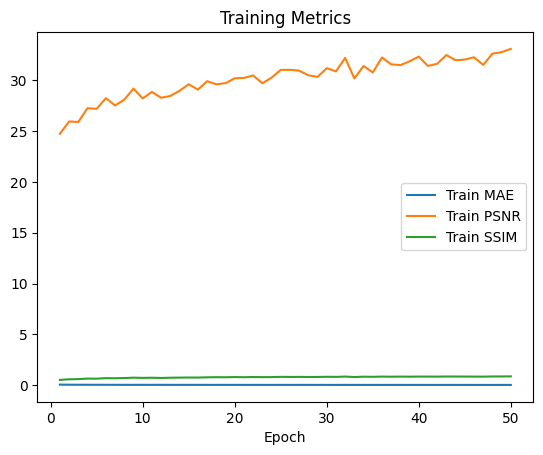

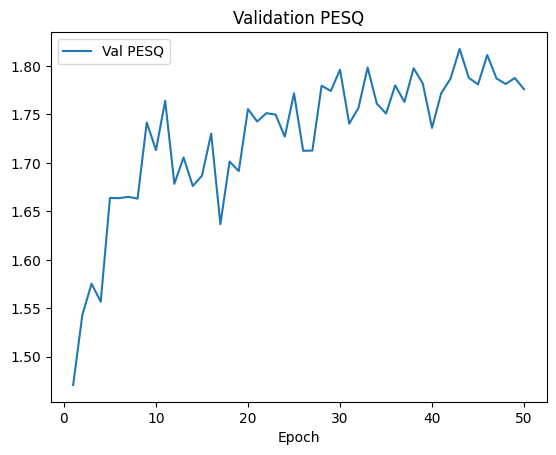

In [41]:
from torch.utils.data import Subset, DataLoader
import numpy as np

full_dataset = AudioDenoiseDataset(
    clean_folder=clean_dir,
    noise_folder=noise_dir,
    sample_rate=8000,
    frame_length=8064,
    hop_length_frame=8000,
    n_fft=255,
    hop_length_fft=63,
    nb_samples=5000,
    noise_levels=(0.2, 0.8),
)


num_total = len(full_dataset)
indices = np.arange(num_total)
np.random.shuffle(indices)

train_ratio = 0.8
num_train = int(train_ratio * num_total)
train_idx, val_idx = indices[:num_train], indices[num_train:]


train_dataset = Subset(full_dataset, train_idx)
val_dataset   = Subset(full_dataset, val_idx)

train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True, num_workers=4)
val_loader   = DataLoader(val_dataset,   batch_size=1,  shuffle=False, num_workers=2)

generator = TFDenseUNetGenerator()
discriminator = MultiScaleDiscriminator()

device = "cuda" if torch.cuda.is_available() else "cpu"
generator.to(device)
discriminator.to(device)

history = train(
    generator, discriminator,
    train_dataset, val_dataset,
    num_epochs=50, batch_size=16,
    lr=1e-4, device=device,
    save_dir="checkpoints"
)


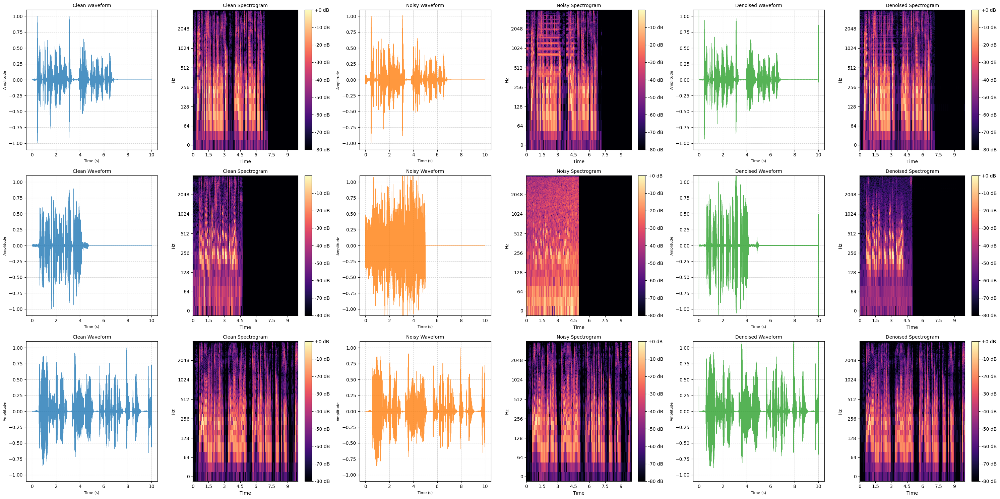


Sample 1 Results:
 PESQ Score: 3.01
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===



Sample 2 Results:
 PESQ Score: 1.94
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===



Sample 3 Results:
 PESQ Score: 2.39
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===


In [57]:
def visualize_denoising_sample(model, dataset, device, num_samples=3, duration=10):
    model.eval()
    sr = dataset.sr
    n_fft = dataset.n_fft
    hop_fft = dataset.hop_fft
    target_len = int(duration * sr)

    fig, axs = plt.subplots(num_samples, 6, figsize=(30, num_samples*5))
    
    results = []
    
    for i in range(num_samples):
        clean_path = random.choice(dataset.clean_files)
        noise_path = random.choice(dataset.noise_files)
        
        clean, _ = librosa.load(clean_path, sr=sr)
        clean = clean[:target_len] if len(clean) >= target_len else np.pad(clean, (0, target_len - len(clean)))
        
        noise, _ = librosa.load(noise_path, sr=sr)
        noise = noise[:target_len] if len(noise) >= target_len else np.pad(noise, (0, target_len - len(noise)))
        
        level = np.random.uniform(*dataset.noise_levels)
        noisy = clean + level * noise

        S_clean = librosa.stft(clean, n_fft=n_fft, hop_length=hop_fft, center=False)
        S_noisy = librosa.stft(noisy, n_fft=n_fft, hop_length=hop_fft, center=False)
        phase = np.angle(S_noisy)
        
        with torch.no_grad():
            mag_noisy = np.abs(S_noisy)
            log_mag = np.log1p(mag_noisy)
            max_val = np.max(np.abs(log_mag)) + 1e-9
            log_mag_norm = log_mag / max_val
            
            F, T = log_mag_norm.shape
            log_mag_padded = pad_to_multiple(log_mag_norm, mult=8)
            
            input_tensor = torch.from_numpy(log_mag_padded).unsqueeze(0).unsqueeze(0).float().to(device)
            
            output = model(input_tensor)
            
            denoised_log_norm = output.squeeze().cpu().numpy()
            denoised_log = denoised_log_norm * max_val
            mag_denoised = np.exp(denoised_log) - 1
            
            mag_denoised = mag_denoised[:F, :T]
        
        denoised_stft = mag_denoised * np.exp(1j * phase)
        denoised = librosa.istft(denoised_stft, hop_length=hop_fft, center=False)
        denoised = np.pad(denoised, (0, target_len - len(denoised)))[:target_len]

        try:
            pesq_score = pesq(sr, clean, denoised, 'nb')
        except Exception as e:
            pesq_score = None
            print(f"PESQ calculation failed for sample {i+1}: {str(e)}")

        results.append({
            'clean': clean,
            'noisy': noisy,
            'denoised': denoised,
            'pesq': pesq_score
        })

        time = np.linspace(0, duration, target_len)
        max_clean = np.max(np.abs(clean)) + 1e-9
        colors = ['#1f77b4', '#ff7f0e', '#2ca02c']
        
        for j, (sig, title) in enumerate(zip(
            [clean, noisy, denoised],
            ["Clean", "Noisy", "Denoised"]
        )):
            ax = axs[i, j*2]
            ax.plot(time, sig/max_clean,
                   color=colors[j],
                   linewidth=0.8,
                   alpha=0.8)
            ax.set_ylim(-1.1, 1.1)
            ax.set_xlabel('Time (s)', fontsize=8)
            ax.set_ylabel('Amplitude', fontsize=8)
            ax.set_title(f"{title} Waveform", fontsize=10)
            ax.grid(True, linestyle='--', alpha=0.5)
            
            ax = axs[i, j*2+1]
            S = librosa.amplitude_to_db(np.abs(librosa.stft(sig, n_fft=n_fft)), 
                                      ref=np.max)
            img = librosa.display.specshow(S, 
                                         sr=sr, 
                                         hop_length=hop_fft,
                                         x_axis='time', 
                                         y_axis='log',
                                         ax=ax,
                                         cmap='magma')
            ax.set_title(f"{title} Spectrogram", fontsize=10)
            fig.colorbar(img, ax=ax, format='%+2.0f dB')

    plt.tight_layout()
    plt.show()
    
    for idx, result in enumerate(results):
        max_audio = np.max(np.abs(result['clean']))
        print(f"\nSample {idx+1} Results:")
        if result['pesq'] is not None:
            print(f" PESQ Score: {result['pesq']:.2f}")
        
        for key in ['clean', 'noisy', 'denoised']:
            print(f"=== {key.capitalize()} Audio ===")
            display(Audio(result[key]/max_audio, rate=sr))


dataset = AudioDenoiseDataset(
    clean_folder=clean_dir,
    noise_folder=noise_dir,
    sample_rate=8000,
    frame_length=8064,
    hop_length_frame=8000,
    n_fft=255,
    hop_length_fft=63,
    nb_samples=50,
    noise_levels=(0.2, 0.8),
)

visualize_denoising_sample(generator, dataset, device, num_samples=3, duration=10)

In [ ]:
print(1)

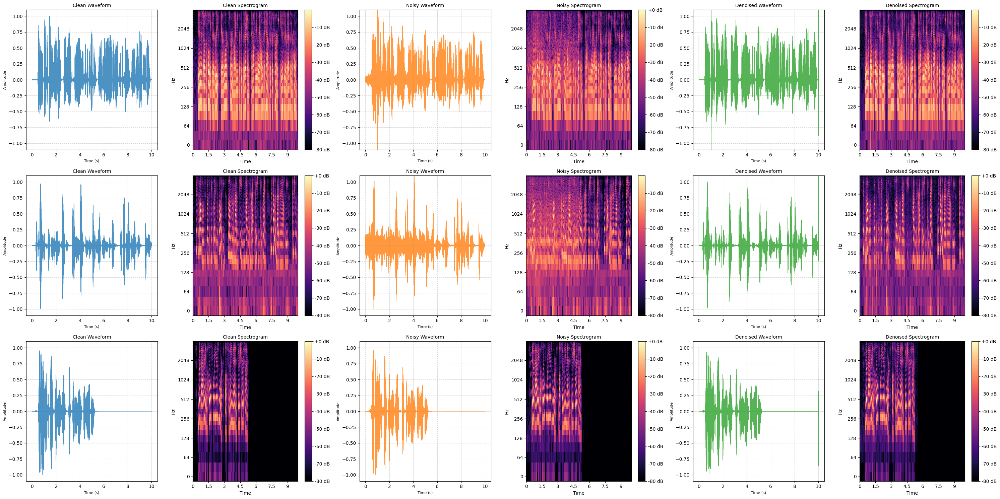


Sample 1 Results:
 PESQ Score: 3.51
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===



Sample 2 Results:
 PESQ Score: 2.55
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===



Sample 3 Results:
 PESQ Score: 4.16
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===


In [56]:
visualize_denoising_sample(generator, dataset, device, num_samples=3, duration=10)

# 10000 data, 30 epochs

Epoch 1/30: 100%|██████████| 500/500 [01:11<00:00,  6.96it/s, MAE=0.0382, PSNR=25.9, SSIM=0.557]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Saved the best model


Epoch 2/30: 100%|██████████| 500/500 [01:11<00:00,  6.95it/s, MAE=0.0287, PSNR=26.8, SSIM=0.633]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Saved the best model


Epoch 3/30: 100%|██████████| 500/500 [01:12<00:00,  6.94it/s, MAE=0.0251, PSNR=28, SSIM=0.688]  


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Saved the best model


Epoch 4/30: 100%|██████████| 500/500 [01:11<00:00,  6.96it/s, MAE=0.023, PSNR=28.4, SSIM=0.71]  


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 5/30: 100%|██████████| 500/500 [01:11<00:00,  6.98it/s, MAE=0.022, PSNR=28.5, SSIM=0.724] 


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Saved the best model


Epoch 6/30: 100%|██████████| 500/500 [01:11<00:00,  6.96it/s, MAE=0.0209, PSNR=29.1, SSIM=0.745]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 7/30: 100%|██████████| 500/500 [01:11<00:00,  6.97it/s, MAE=0.02, PSNR=29.6, SSIM=0.757]  


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Saved the best model


Epoch 8/30: 100%|██████████| 500/500 [01:11<00:00,  6.98it/s, MAE=0.0193, PSNR=29.2, SSIM=0.761]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 9/30: 100%|██████████| 500/500 [01:11<00:00,  6.98it/s, MAE=0.0184, PSNR=30.1, SSIM=0.782]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 10/30: 100%|██████████| 500/500 [01:11<00:00,  6.96it/s, MAE=0.0179, PSNR=30.1, SSIM=0.785]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Saved the best model


Epoch 11/30: 100%|██████████| 500/500 [01:12<00:00,  6.94it/s, MAE=0.0174, PSNR=30.1, SSIM=0.794]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 12/30: 100%|██████████| 500/500 [01:11<00:00,  6.95it/s, MAE=0.0171, PSNR=30.3, SSIM=0.787]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 13/30: 100%|██████████| 500/500 [01:11<00:00,  6.97it/s, MAE=0.0166, PSNR=30.8, SSIM=0.804]


PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 14/30: 100%|██████████| 500/500 [01:11<00:00,  6.96it/s, MAE=0.0159, PSNR=31.5, SSIM=0.819]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 15/30: 100%|██████████| 500/500 [01:11<00:00,  6.97it/s, MAE=0.0158, PSNR=30.7, SSIM=0.806]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 16/30: 100%|██████████| 500/500 [01:11<00:00,  6.96it/s, MAE=0.0153, PSNR=31.6, SSIM=0.821]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 17/30: 100%|██████████| 500/500 [01:11<00:00,  6.95it/s, MAE=0.015, PSNR=31.2, SSIM=0.816] 


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 18/30: 100%|██████████| 500/500 [01:11<00:00,  6.97it/s, MAE=0.015, PSNR=31.6, SSIM=0.82]  


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 19/30: 100%|██████████| 500/500 [01:11<00:00,  6.97it/s, MAE=0.0145, PSNR=31.7, SSIM=0.825]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Saved the best model


Epoch 20/30: 100%|██████████| 500/500 [01:11<00:00,  6.97it/s, MAE=0.0143, PSNR=32, SSIM=0.838]  


PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 21/30: 100%|██████████| 500/500 [01:11<00:00,  6.97it/s, MAE=0.0144, PSNR=32, SSIM=0.839]  


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 22/30: 100%|██████████| 500/500 [01:11<00:00,  6.95it/s, MAE=0.0141, PSNR=32, SSIM=0.833]  


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 23/30: 100%|██████████| 500/500 [01:12<00:00,  6.94it/s, MAE=0.0136, PSNR=32.2, SSIM=0.845]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 24/30: 100%|██████████| 500/500 [01:12<00:00,  6.94it/s, MAE=0.0137, PSNR=32.6, SSIM=0.843]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 25/30: 100%|██████████| 500/500 [01:12<00:00,  6.94it/s, MAE=0.0135, PSNR=32.3, SSIM=0.845]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 26/30: 100%|██████████| 500/500 [01:12<00:00,  6.93it/s, MAE=0.0133, PSNR=32.9, SSIM=0.854]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Saved the best model


Epoch 27/30: 100%|██████████| 500/500 [01:12<00:00,  6.90it/s, MAE=0.0131, PSNR=32.5, SSIM=0.844]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 28/30: 100%|██████████| 500/500 [01:12<00:00,  6.94it/s, MAE=0.0131, PSNR=32.6, SSIM=0.849]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 29/30: 100%|██████████| 500/500 [01:12<00:00,  6.94it/s, MAE=0.0127, PSNR=33.4, SSIM=0.865]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 30/30: 100%|██████████| 500/500 [01:12<00:00,  6.94it/s, MAE=0.0127, PSNR=33.3, SSIM=0.86] 


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Saved the best model


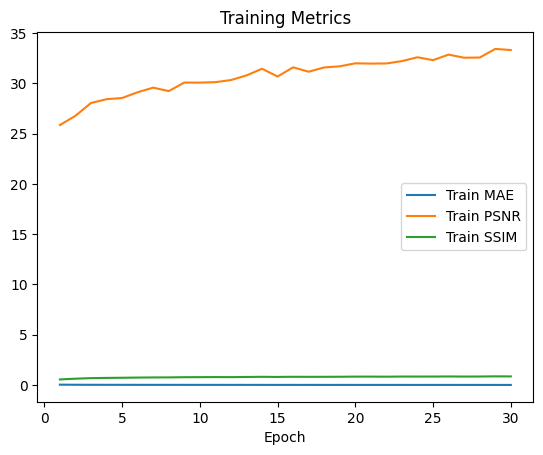

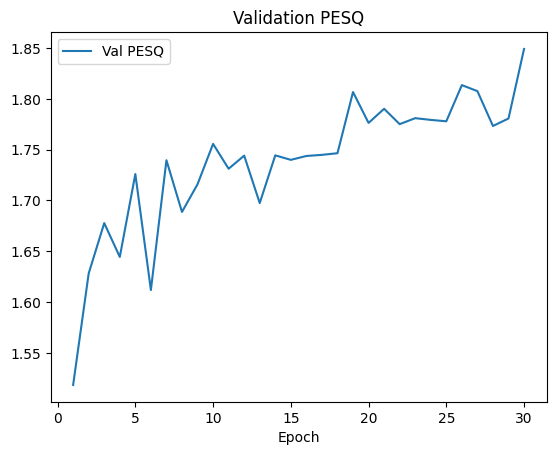

Training completed in 3978.94 seconds.


In [59]:
from torch.utils.data import Subset, DataLoader
import numpy as np
import time


full_dataset = AudioDenoiseDataset(
    clean_folder=clean_dir,
    noise_folder=noise_dir,
    sample_rate=8000,
    frame_length=8064,
    hop_length_frame=8000,
    n_fft=255,
    hop_length_fft=63,
    nb_samples=10000,
    noise_levels=(0.2, 0.8),
)


num_total = len(full_dataset)
indices = np.arange(num_total)
np.random.shuffle(indices)

train_ratio = 0.8
num_train = int(train_ratio * num_total)
train_idx, val_idx = indices[:num_train], indices[num_train:]


train_dataset = Subset(full_dataset, train_idx)
val_dataset   = Subset(full_dataset, val_idx)

train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True, num_workers=4)
val_loader   = DataLoader(val_dataset,   batch_size=1,  shuffle=False, num_workers=2)

generator = TFDenseUNetGenerator()
discriminator = MultiScaleDiscriminator()

device = "cuda" if torch.cuda.is_available() else "cpu"
generator.to(device)
discriminator.to(device)

start_time = time.time()

history = train(
    generator, discriminator,
    train_dataset, val_dataset,
    num_epochs=30, batch_size=16,
    lr=1e-4, device=device,
    save_dir="checkpoints"
)
end_time = time.time()

elapsed_time = end_time - start_time
print(f"Training completed in {elapsed_time:.2f} seconds.")

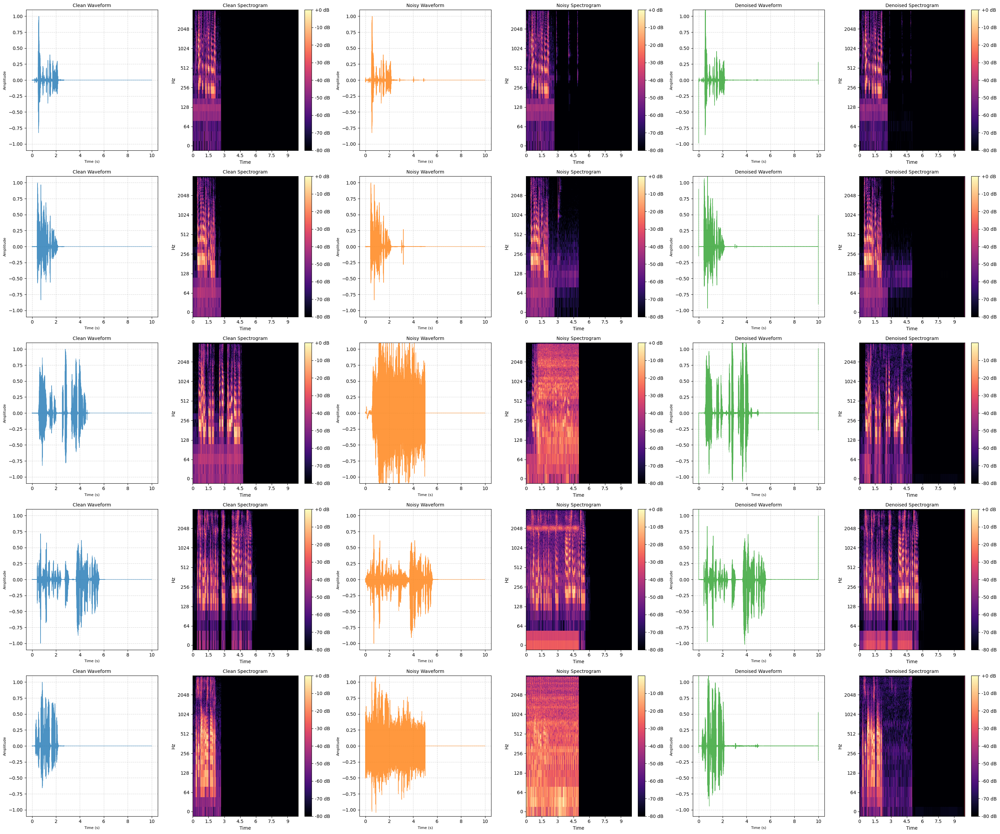


Sample 1 Results:
 PESQ Score: 3.79
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===



Sample 2 Results:
 PESQ Score: 3.77
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===



Sample 3 Results:
 PESQ Score: 1.52
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===



Sample 4 Results:
 PESQ Score: 3.36
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===



Sample 5 Results:
 PESQ Score: 2.40
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===


In [61]:
dataset = AudioDenoiseDataset(
    clean_folder=clean_dir,
    noise_folder=noise_dir,
    sample_rate=8000,
    frame_length=8064,
    hop_length_frame=8000,
    n_fft=255,
    hop_length_fft=63,
    nb_samples=50,
    noise_levels=(0.2, 0.8),
)

visualize_denoising_sample(generator, dataset, device, num_samples=5, duration=10)

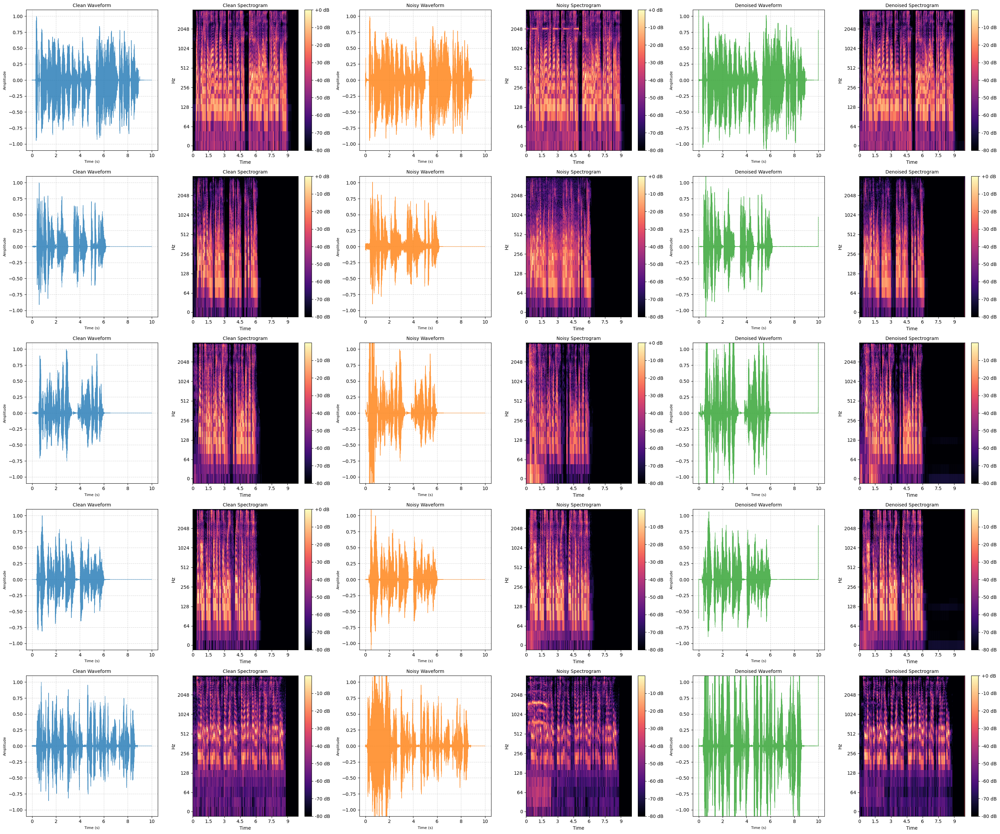


Sample 1 Results:
 PESQ Score: 3.56
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===



Sample 2 Results:
 PESQ Score: 3.05
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===



Sample 3 Results:
 PESQ Score: 3.11
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===



Sample 4 Results:
 PESQ Score: 3.71
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===



Sample 5 Results:
 PESQ Score: 3.98
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===


In [62]:
visualize_denoising_sample(generator, dataset, device, num_samples=5, duration=10)

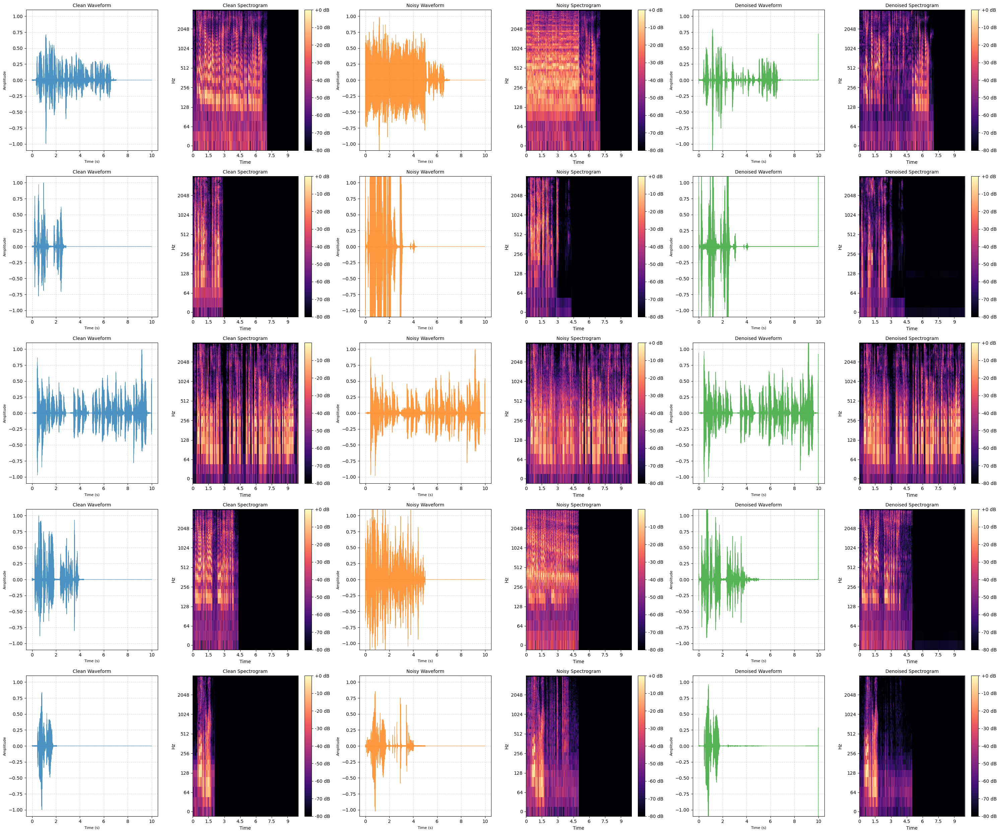


Sample 1 Results:
 PESQ Score: 1.52
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===



Sample 2 Results:
 PESQ Score: 1.77
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===



Sample 3 Results:
 PESQ Score: 2.95
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===



Sample 4 Results:
 PESQ Score: 1.53
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===



Sample 5 Results:
 PESQ Score: 2.57
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===


In [65]:
visualize_denoising_sample(generator, dataset, device, num_samples=5, duration=10)